# Fuel Prices in NSW
## Fuel Stations and Fuel Depots

Fuel prices are always something drivers would wonder and fuelling at a cheaper fuel station might save you a lot of money. In this presentation, we will look at the relationship between fuel stations and fuel depots. We will look at the fuel depots owned by companies and the fuel prices from fuel stations. I will draw out a specific type of fuel to analyse and we'll have a look at if a station is closer to a depot, will the fuel actually be cheaper than the ones that aren't near one.

In [159]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import geopandas as gp
import fiona
import os
from datetime import datetime
import geopy
from geopy.geocoders import Nominatim
import shapely
import folium
from folium import Marker

shp_file_name = "NSW_LOC_POLYGON_shp/NSW_LOC_POLYGON_shp.shp"
zip_file_name = "nsw_loc_polygon_shp.zip"
web_file_path = (
    "https://data.gov.au/data/dataset/"
    "91e70237-d9d1-4719-a82f-e71b811154c6/resource/"
    "5e295412-357c-49a2-98d5-6caf099c2339/download/"
    "nsw_locality_polygon_shp.zip")

new_fuel_station_coordinates = pd.read_csv("price_history_checks_may2021.csv")
fuel_stations = pd.read_excel("price_history_checks_may2021.xlsx")
fuel_depots = pd.read_csv("LiquidFuelDepots_v1.csv")
fuel_station_coordinates = pd.read_csv("stations_lat_long.csv")
print("done")


done


In [160]:
%matplotlib inline
plt.rcParams['figure.figsize'] = (30, 25)


In [161]:
# give us a style state to go back to
saved_style_state = matplotlib.rcParams.copy()


In [162]:
def unzip_zipfile(zipped_file_path, put_it_here="."):
    import zipfile
    zip_of_suburbs = zipfile.ZipFile(zipped_file_path, 'r')
    zip_of_suburbs.extractall(put_it_here)
    zip_of_suburbs.close()


In [163]:
if os.path.isfile(shp_file_name):
    print("loading from file")
else:
    if os.path.isfile(zip_file_name):
        print("unzipping")
        unzip_zipfile(zip_file_name)
    else:
        import requests
        print("loading from the internet")
        page = requests.get(web_file_path)
        with open(zip_file_name, 'wb') as z:
            z.write(page.content)
        unzip_zipfile(zip_file_name)

print("done")


loading from file
done


In [164]:
burbs = gp.GeoDataFrame.from_file(shp_file_name)
burbs.set_crs(epsg=5234, inplace=True, allow_override=True)
# https://epsg.io/8021
# GDA2020 is the latest and least wrong coord set for Sydney
burbs.sample(2)


,LC_PLY_PID,DT_CREATE,DT_RETIRE,LOC_PID,NSW_LOCALI,NSW_LOCA_1,NSW_LOCA_2,NSW_LOCA_3,NSW_LOCA_4,NSW_LOCA_5,NSW_LOCA_6,NSW_LOCA_7,geometry
654,34303,2021-02-09,None,NSW3643,2013-11-01,None,SPLITTERS CREEK,None,None,G,None,1,"POLYGON ((146.87725 -36.04560, 146.87733 -36.0..."
2400,34822,2021-02-09,None,NSW3718,2016-08-08,None,SUFFOLK PARK,None,None,G,None,1,"POLYGON ((153.61794 -28.67936, 153.61768 -28.6..."


Before we start, I would like to briefly show you how i started with the original dataset and turned it into something that i can use for map plotting.


This is the original dataset. It looks extremely messy

In [165]:
fuel_stations.sample(5)

,ServiceStationName,Address,Suburb,Postcode,Brand,FuelCode,PriceUpdatedDate,Price
26536,Payless Fuel Sydenham,"31-35 Unwins Bridge, Sydenham NSW 2044",Sydenham,2044.0,Independent,U91,16/05/2021 8:39:41 PM,124.9
9065,Coles Express Thornleigh,"188-190 Pennant Hills Rd, Thornleigh NSW 2120",Thornleigh,2120.0,Coles Express,P95,5/05/2021 10:05:39 AM,168.9
10780,Metro Condell Park West,"132-134 Edgar St, CONDELL PARK NSW 2200",CONDELL PARK,2200.0,Metro Fuel,U91,6/05/2021 6:09:03 AM,126.7
5151,NaN,NaN,NaN,NaN,NaN,E10,3/05/2021 6:16:58 PM,137.4
4384,NaN,NaN,NaN,NaN,NaN,U91,3/05/2021 12:00:55 PM,130.9


Then here's a function to sort out the dates.

In [166]:
def dateparser(x): return pd.to_datetime(x, dayfirst=True)


price_df = pd.read_excel(
    "price_history_checks_may2021.xlsx", parse_dates=["PriceUpdatedDate"], date_parser=dateparser
)

price_df.head()


,ServiceStationName,Address,Suburb,Postcode,Brand,FuelCode,PriceUpdatedDate,Price
0,Metro Fuel Killarney Heights,"702-704 Warringah Road, Forestville NSW 2087",Forestville,2087.0,Metro Fuel,U91,2021-05-01 00:01:20,137.9
1,NaN,NaN,NaN,NaN,NaN,E10,2021-05-01 00:01:20,135.9
2,NaN,NaN,NaN,NaN,NaN,P98,2021-05-01 00:01:20,155.9
3,Caltex Cambridge,"Lot 6 Star Court, CAMBRIDGE PARK NSW 2747",CAMBRIDGE PARK,2747.0,Caltex,P95,2021-05-01 00:06:09,152.9
4,Westside Adamstown,"125 Brunker Rd, Adamstown NSW 2289",Adamstown,2289.0,Westside,DL,2021-05-01 00:07:01,136.9


As you can see above in the original data, some of the columns returned NaN. The codes below will look for the related updated dates and create a new column accordingly. 

As Ben said, whoever created this data file is a jerk.

In [167]:
fuel_codes = price_df.FuelCode.unique()
fuel_codes = [x for x in fuel_codes if type(x) is str]
print(fuel_codes)

new_column_names = (
    [f"Price_{name}_UpdatedDate" for name in fuel_codes]
    + [f"Price_{name}" for name in fuel_codes]
    + [
        name
        for name in price_df.columns
        if name not in ["FuelCode", "PriceUpdatedDate", "Price"]
    ]
)
new_column_names.sort()
print(new_column_names)
new_rows = []
temp_row = pd.Series(index=new_column_names, dtype=object)

for i, row in price_df.iterrows():
    fc = row.FuelCode
    if row.ServiceStationName is not np.NaN:
        new_rows.append(temp_row)
        temp_row = pd.Series(index=new_column_names, dtype=object)
        for key, element in row.iteritems():
            if key in temp_row.index:
                temp_row[key] = element
        temp_row[f"Price_{fc}_UpdatedDate"] = row.PriceUpdatedDate
        temp_row[f"Price_{fc}"] = row.Price
    elif row.ServiceStationName is np.NaN:
        temp_row[f"Price_{fc}_UpdatedDate"] = row.PriceUpdatedDate
        temp_row[f"Price_{fc}"] = row.Price

reshaped_df = pd.DataFrame(new_rows)
reshaped_df.drop([0], inplace=True)
reshaped_df.head()


['U91', 'E10', 'P98', 'P95', 'DL', 'PDL', 'LPG', 'E85']
['Address', 'Brand', 'Postcode', 'Price_DL', 'Price_DL_UpdatedDate', 'Price_E10', 'Price_E10_UpdatedDate', 'Price_E85', 'Price_E85_UpdatedDate', 'Price_LPG', 'Price_LPG_UpdatedDate', 'Price_P95', 'Price_P95_UpdatedDate', 'Price_P98', 'Price_P98_UpdatedDate', 'Price_PDL', 'Price_PDL_UpdatedDate', 'Price_U91', 'Price_U91_UpdatedDate', 'ServiceStationName', 'Suburb']


,Address,Brand,Postcode,Price_DL,Price_DL_UpdatedDate,Price_E10,Price_E10_UpdatedDate,Price_E85,Price_E85_UpdatedDate,Price_LPG,...,Price_P98,Price_P98_UpdatedDate,Price_PDL,Price_PDL_UpdatedDate,Price_U91,Price_U91_UpdatedDate,ServiceStationName,Suburb,Price_nan_UpdatedDate,Price_nan
1,"702-704 Warringah Road, Forestville NSW 2087",Metro Fuel,2087.0,NaN,NaT,135.9,2021-05-01 00:01:20,NaN,NaT,NaN,...,155.9,2021-05-01 00:01:20,NaN,NaT,137.9,2021-05-01 00:01:20,Metro Fuel Killarney Heights,Forestville,NaT,NaN
2,"Lot 6 Star Court, CAMBRIDGE PARK NSW 2747",Caltex,2747.0,NaN,NaT,NaN,NaT,NaN,NaT,NaN,...,NaN,NaT,NaN,NaT,NaN,NaT,Caltex Cambridge,CAMBRIDGE PARK,NaT,NaN
3,"125 Brunker Rd, Adamstown NSW 2289",Westside,2289.0,136.9,2021-05-01 00:07:01,NaN,NaT,NaN,NaT,NaN,...,158.9,2021-05-01 00:07:01,NaN,NaT,NaN,NaT,Westside Adamstown,Adamstown,NaT,NaN
4,"323 River Street, BALLINA NSW 2478",Metro Fuel,2478.0,NaN,NaT,139.9,2021-05-01 00:14:40,NaN,NaT,NaN,...,161.9,2021-05-01 00:14:40,137.9,2021-05-01 00:14:40,142.9,2021-05-01 00:14:40,Metro Petroleum Ballina,BALLINA,NaT,NaN
5,"656 Warringah Road, FORESTVILLE NSW 2087",Metro Fuel,2087.0,NaN,NaT,135.9,2021-05-01 00:15:42,NaN,NaT,NaN,...,NaN,NaT,NaN,NaT,137.9,2021-05-01 00:15:42,Metro Petroleum Forestville,FORESTVILLE,NaT,NaN


After that, we will also need the lat and long in order to generate maps. 

In [168]:
# geolocator = Nominatim(timeout=10, user_agent= "myGeolocator")
# stations = []
# for station in reshaped_df.Address.unique():
#     try:
#         location = geolocator.geocode(station)
#         print(location.longitude, location.latitude)
#         di = {"station":station, "location":location, "latitude":location.latitude, "longitude":location.longitude}
#     except Exception as e:
#         di = {"station":station, "location":None, "latitude":None, "longitude":None, "Error":e}
#     stations.append(di)
    


Because of the run time to generate the coordinates, I've saved them into a csv file. Saved up a lot of time!

In [169]:
# station_df = pd.DataFrame(stations)
# station_df.to_csv("stations_lat_long.csv")

One last step to get the geometry with shapely. Then we're ready to go.

In [170]:
def shapely_new_depots(row):
    return shapely.geometry.point.Point(row.LONGITUDE, row.LATITUDE)


fuel_depots["geometry"] = fuel_depots.apply(shapely_new_depots, axis=1)
fuel_depots.head()


,OBJECTID,FEATURETYPE,DESCRIPTION,CLASS,FID,NAME,OPERATIONALSTATUS,OPERATOR,OWNER,ADDRESS,SUBURB,STATE,SPATIALCONFIDENCE,REVISED,COMMENT,LATITUDE,LONGITUDE,geometry
0,1,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,52,Eden,Operational,Caltex,Caltex,Lot 23 Ben Boyd Drive,Eden,New South Wales,4,20121004,8 lay Down tanks + 1 lay down tank possibly fo...,-37.038479,149.891540,POINT (149.8915405 -37.03847885)
1,2,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,53,Temora Fuel Distributors,Operational,Temora Fuel Distributors,BP,9 Ironbark Street,Temora,New South Wales,5,20121004,"3 med + 1 med + 1 separate lay down tank, 2 me...",-34.447685,147.552978,POINT (147.5529785 -34.44768524)
2,3,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,54,Dubbo,Operational,Inland Petroleum,BP,105 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 1 Terminal sized upright + 10...",-32.244324,148.610268,POINT (148.6102676 -32.24432373)
3,4,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,55,Dubbo,Operational,Lowes Petroleum Service,Mobil,107 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 5 large + 2 small upright tan...",-32.244473,148.611153,POINT (148.6111526 -32.2444725)
4,5,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,56,Dubbo,Operational,Shell,Shell,109-113 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 1 terminal sized + 1 small up...",-32.244732,148.612396,POINT (148.6123962 -32.2447319)


In [171]:
def shapely_new_stations(row):
    return shapely.geometry.point.Point(row.longitude, row.latitude)


fuel_station_coordinates["geometry"] = fuel_station_coordinates.apply(
    shapely_new_stations, axis=1)
fuel_station_coordinates.head()

,Number,station,location,latitude,longitude,owner,Price_U91,Price_P98,geometry
0,0,"702-704 Warringah Road, Forestville NSW 2087","Warringah Road, Forestville, Sydney, Northern ...",-33.760921,151.216115,Metro Fuel,137.9,155.9,POINT (151.2161153 -33.7609212)
1,2,"125 Brunker Rd, Adamstown NSW 2289","Brunker Road, Adamstown, Newcastle, Newcastle ...",-32.943960,151.722761,Westside,Not Selling U91,158.9,POINT (151.7227611 -32.9439598)
2,3,"323 River Street, BALLINA NSW 2478","323, River Street, Ballina CBD, Ballina, Balli...",-28.866000,153.550280,Metro Fuel,142.9,161.9,POINT (153.5502802 -28.86600025)
3,4,"656 Warringah Road, FORESTVILLE NSW 2087","Warringah Road, Forestville, Sydney, Northern ...",-33.760921,151.216115,Metro Fuel,137.9,Not Selling P98,POINT (151.2161153 -33.7609212)
4,5,"198 Hill End Road, Doonside NSW 2767","Hill End Road, Doonside, Sydney, Blacktown Cit...",-33.761139,150.869841,Metro Fuel,Not Selling U91,Not Selling P98,POINT (150.8698407 -33.7611391)


In [172]:
fuel_station_coordinates_geo = gp.GeoDataFrame(fuel_station_coordinates)
fuel_depots_geo = gp.GeoDataFrame(fuel_depots)

Ok now we're set lets start plotting graphs.

In [173]:
def fuel_depot_owners_graph():
    fuel_depot_data = fuel_depots["OWNER"].value_counts()
    fuel_depot_data.plot.barh()
    plt.title("Amount of fuel depots owned by companies", fontsize=20)
    plt.xlabel("Number of Depots", fontsize=10)
    plt.ylabel("Company Name", fontsize=10)


We first start with the depots owned by companies. As you can see, Caltex owned the most amount of fuel depots following by BP, Mobil and Shell. Caltex owned more depots than all BP, Mobil and Shell combined. Interestingly you can't find Coles anywhere. Oh also one of the depots was owned by a truck repair company.

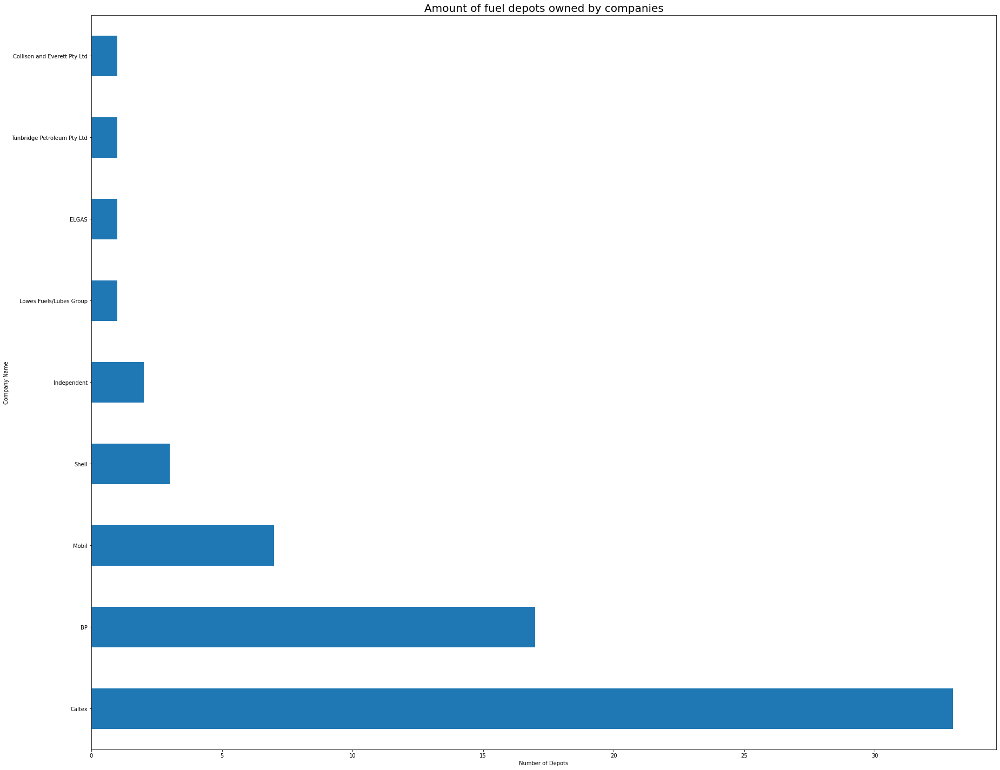

In [174]:
fuel_depot_owners_graph()

This raised a question. Since Caltex has so many depots, will they have a cheaper fuel price selling at the fuel station?
How about Coles, what whould the relationship be?

In [175]:
reshaped_df["Address_Brand"] = reshaped_df.apply(lambda row: f"{row.Address} {row.Brand}", axis =1)

In [176]:
df_withtime = reshaped_df[(reshaped_df.Price_U91_UpdatedDate > "2021-05-01 00:07:01")
                 & (reshaped_df.Price_U91_UpdatedDate < "2021-05-31 23:59:59")]
price_frame_df = df_withtime[df_withtime.Price_U91>140]
price_frame_df.head()

,Address,Brand,Postcode,Price_DL,Price_DL_UpdatedDate,Price_E10,Price_E10_UpdatedDate,Price_E85,Price_E85_UpdatedDate,Price_LPG,...,Price_P98_UpdatedDate,Price_PDL,Price_PDL_UpdatedDate,Price_U91,Price_U91_UpdatedDate,ServiceStationName,Suburb,Price_nan_UpdatedDate,Price_nan,Address_Brand
4,"323 River Street, BALLINA NSW 2478",Metro Fuel,2478.0,NaN,NaT,139.9,2021-05-01 00:14:40,NaN,NaT,NaN,...,2021-05-01 00:14:40,137.9,2021-05-01 00:14:40,142.9,2021-05-01 00:14:40,Metro Petroleum Ballina,BALLINA,NaT,NaN,"323 River Street, BALLINA NSW 2478 Metro Fuel"
21,"20 Burwood Road, CONCORD NSW 2137",BP,2137.0,NaN,NaT,145.9,2021-05-01 04:58:19,NaN,NaT,NaN,...,2021-05-01 04:58:19,NaN,NaT,147.9,2021-05-01 04:58:19,BP CONCORD,CONCORD,NaT,NaN,"20 Burwood Road, CONCORD NSW 2137 BP"
27,"4 Lake Street, Windale NSW 2306",Independent,2306.0,NaN,NaT,157.9,2021-05-01 05:07:39,NaN,NaT,NaN,...,2021-05-01 05:07:39,NaN,NaT,159.9,2021-05-01 05:07:39,Medco Windale,Windale,NaT,NaN,"4 Lake Street, Windale NSW 2306 Independent"
40,"533,Mowbray Rd, Lane Cove NSW 2066",Metro Fuel,2066.0,NaN,NaT,NaN,NaT,NaN,NaT,NaN,...,2021-05-01 06:18:53,NaN,NaT,142.7,2021-05-01 06:18:53,Metro Lane Cove,Lane Cove,NaT,NaN,"533,Mowbray Rd, Lane Cove NSW 2066 Metro Fuel"
57,"450 Great Western Hw, Faulconbridge NSW 2776",Mobil,2776.0,NaN,NaT,144.9,2021-05-01 07:00:50,NaN,NaT,NaN,...,2021-05-01 07:00:50,NaN,NaT,147.9,2021-05-01 07:00:50,Mobil Faulconbridge,Faulconbridge,NaT,NaN,"450 Great Western Hw, Faulconbridge NSW 2776 M..."


In [177]:
df_withtime = reshaped_df[(reshaped_df.Price_U91_UpdatedDate > "2021-05-01 00:07:01")
                 & (reshaped_df.Price_U91_UpdatedDate < "2021-05-31 23:59:59")]
price_frame_df_low = df_withtime[df_withtime.Price_U91<130]
price_frame_df_low.head()

,Address,Brand,Postcode,Price_DL,Price_DL_UpdatedDate,Price_E10,Price_E10_UpdatedDate,Price_E85,Price_E85_UpdatedDate,Price_LPG,...,Price_P98_UpdatedDate,Price_PDL,Price_PDL_UpdatedDate,Price_U91,Price_U91_UpdatedDate,ServiceStationName,Suburb,Price_nan_UpdatedDate,Price_nan,Address_Brand
12,"332-336 Shellharbour Rd, BARRACK HEIGHTS NSW 2528",Ampol,2528.0,NaN,NaT,125.9,2021-05-01 02:32:49,NaN,NaT,NaN,...,2021-05-01 02:32:49,NaN,NaT,127.9,2021-05-01 02:32:49,Ampol Barrack Heights,BARRACK HEIGHTS,NaT,NaN,"332-336 Shellharbour Rd, BARRACK HEIGHTS NSW 2..."
17,"6b 1-10 Amy Close, WYONG NSW 2259",Metro Fuel,2259.0,125.9,2021-05-01 04:27:01,122.9,2021-05-01 04:27:01,NaN,NaT,NaN,...,NaT,NaN,NaT,124.9,2021-05-01 04:27:01,Metro North Wyong,WYONG,NaT,NaN,"6b 1-10 Amy Close, WYONG NSW 2259 Metro Fuel"
18,"150 Pacific Hwy, TUGGERAH NSW 2259",Metro Fuel,2259.0,NaN,NaT,122.9,2021-05-01 04:29:29,NaN,NaT,NaN,...,NaT,126.9,2021-05-01 04:29:29,124.9,2021-05-01 04:29:29,Metro Tuggerah,TUGGERAH,NaT,NaN,"150 Pacific Hwy, TUGGERAH NSW 2259 Metro Fuel"
19,"380 Wollombi Rd, BELLBIRD NSW 2325",Metro Fuel,2325.0,NaN,NaT,124.5,2021-05-01 04:50:56,NaN,NaT,NaN,...,NaT,NaN,NaT,126.5,2021-05-01 04:50:56,Metro Petroleum Bellbird,BELLBIRD,NaT,NaN,"380 Wollombi Rd, BELLBIRD NSW 2325 Metro Fuel"
23,"102 Wollombi Rd, CESSNOCK NSW 2325",Metro Fuel,2325.0,NaN,NaT,122.9,2021-05-01 05:01:18,NaN,NaT,NaN,...,NaT,NaN,NaT,124.9,2021-05-01 05:01:18,Metro Cessnock,CESSNOCK,NaT,NaN,"102 Wollombi Rd, CESSNOCK NSW 2325 Metro Fuel"


In this graph, you will be able to see the fuel prices at each fuel stations owned by different companies. Metro sells the cheapest fuel out of all the companies following by Independent. However, there are rumours saying that their fuels aren't as good as the other big fuel companies. Instead, Coles does sell a bit more expensive than other fuel stations. This could be becuase they didn't own any fuel depots or it is just to match the discounts they have. On the other hand, Caltax owned the most fuel stations, it's prices are still slightly more expensive than BP.

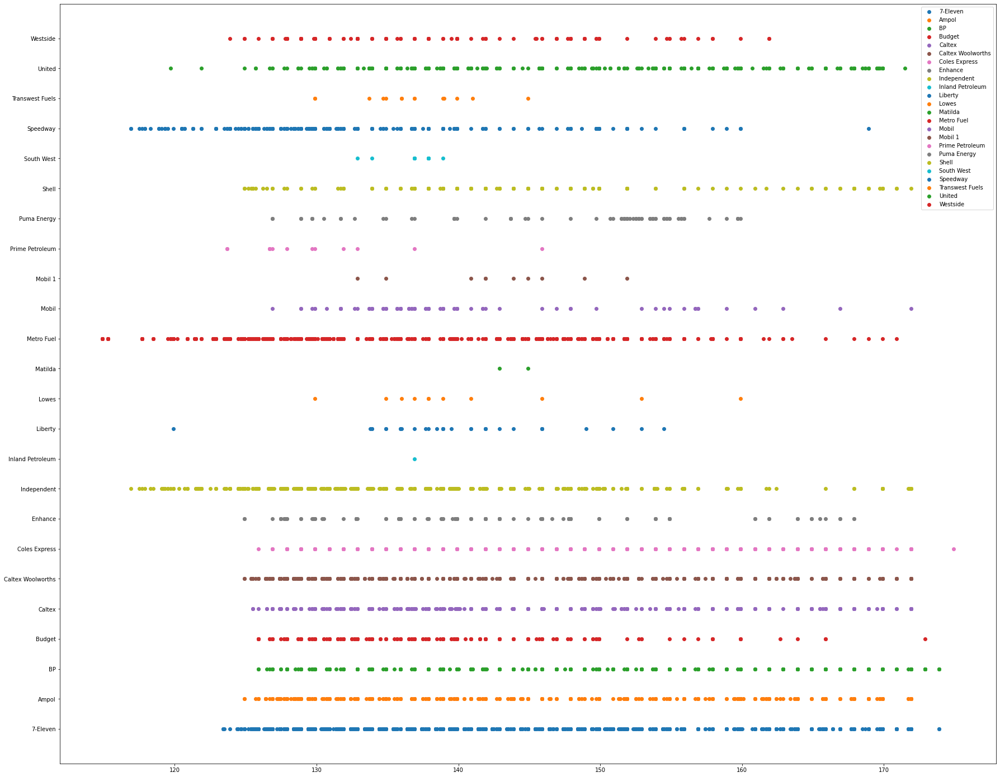

In [178]:
for name, data in df_withtime.groupby("Brand"):
    plt.scatter(data.Price_U91, data.Brand, label = name)
plt.legend()

Here's a clearer plot for stations that sold their fuel over 140.0 and under 130.0. You can see that Coles doesn't actually own that many fuel stations comparing to Caltax.

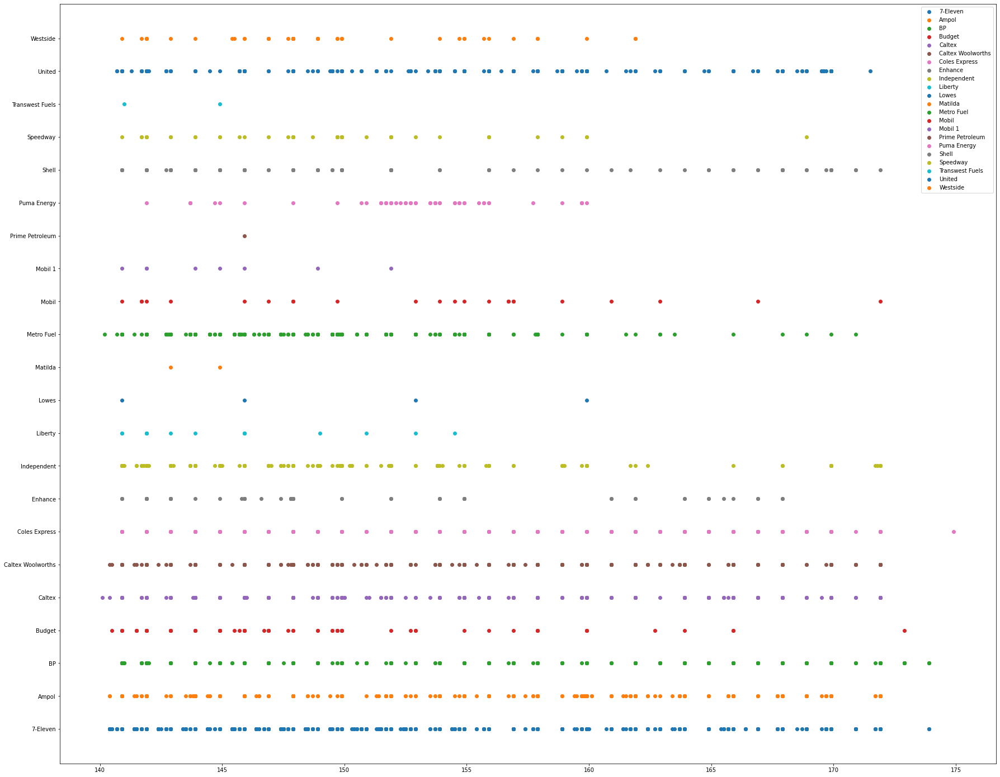

In [179]:
for name, data in price_frame_df.groupby("Brand"):
    plt.scatter(data.Price_U91, data.Brand, label = name)
plt.legend()

And the cheaper side.

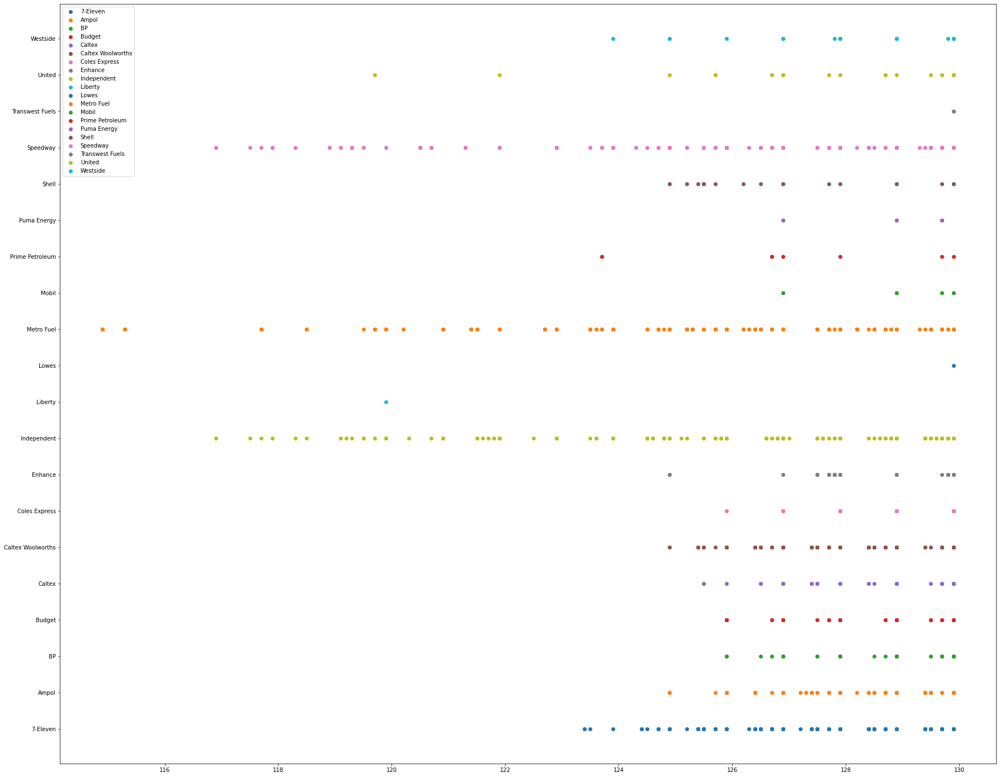

In [180]:
for name, data in price_frame_df_low.groupby("Brand"):
    plt.scatter(data.Price_U91, data.Brand, label = name)
plt.legend()

Also something interesting to look at. The price trend for Unleaded 91 throughout the whole month. The cheapest average prices are on Saturdays and Sundays. 

Text(0.5, 1.0, 'Price trend for Unleaded 91')

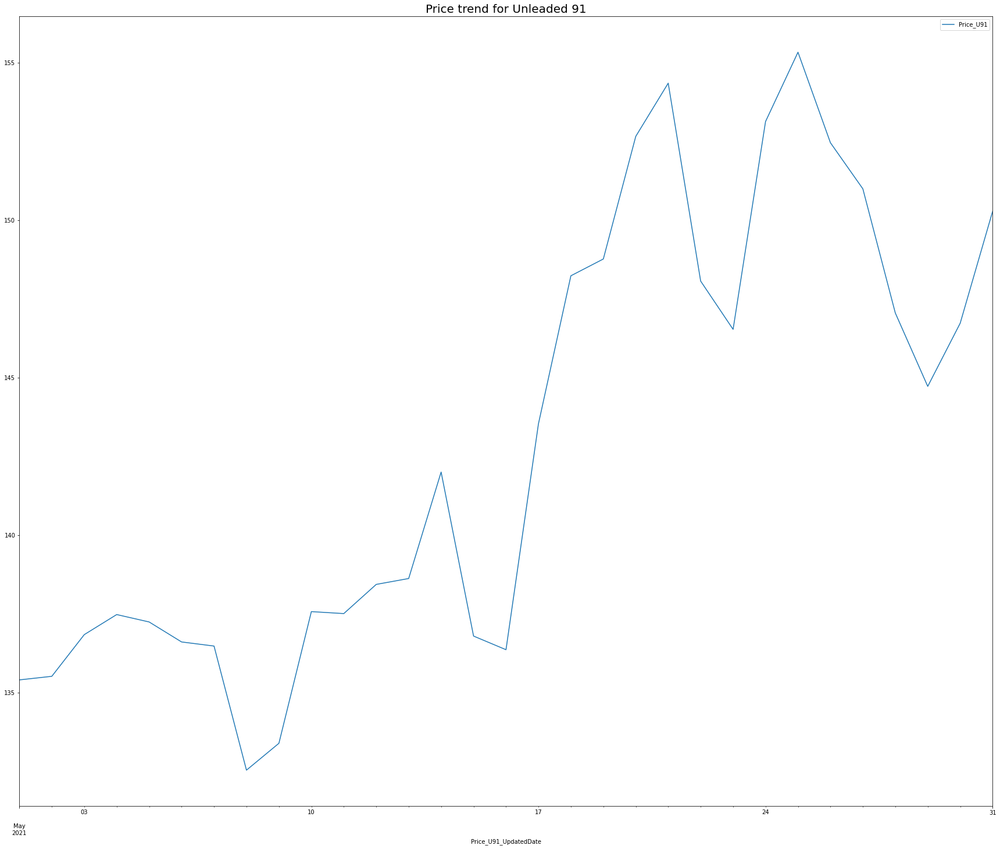

In [181]:
reshaped_df.set_index("Price_U91_UpdatedDate").groupby(pd.Grouper(freq="D")).mean().Price_U91.plot()
plt.legend()
plt.title("Price trend for Unleaded 91", fontsize=20)

Text(0.5, 1.0, 'Price trend for Premium 98')

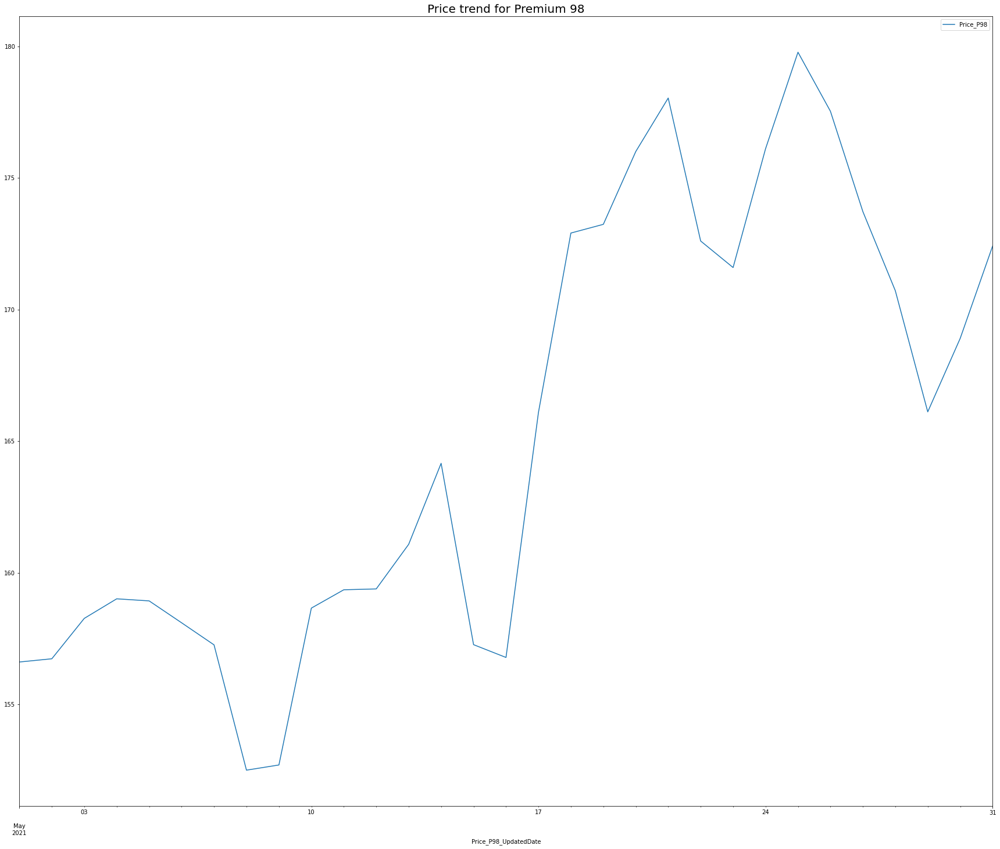

In [182]:
reshaped_df.set_index("Price_P98_UpdatedDate").groupby(pd.Grouper(freq="D")).mean().Price_P98.plot()
plt.legend()
plt.title("Price trend for Premium 98", fontsize=20)

And you can see when they adjust the price for one type of fuel, the other goes up as well on the same day. The two graphs looks the same!

Now lets have a look at the fuel stations and depots on a map.

Text(0.5, 1.0, 'NSW Map with Fuel Stations and Depots')

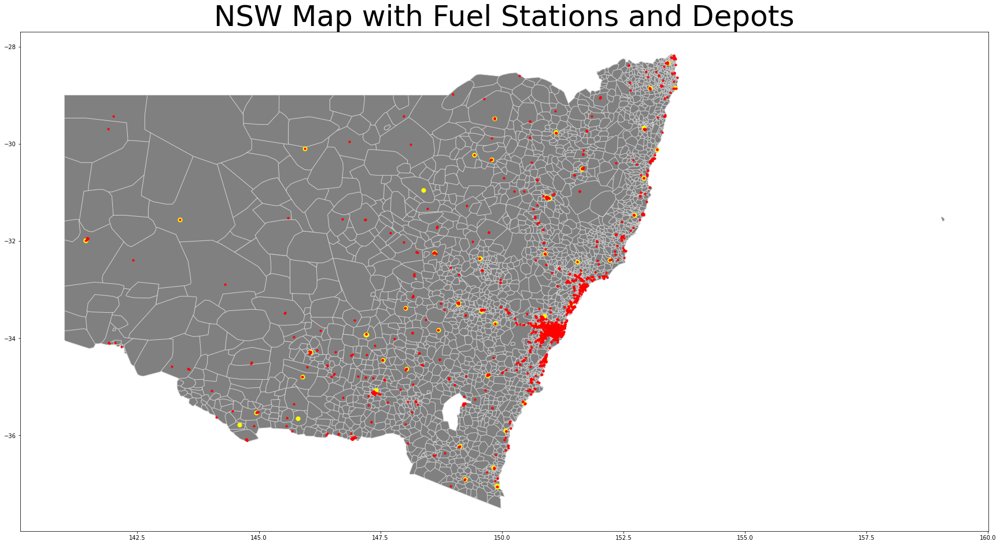

In [198]:
nsw_map = burbs.geometry.convex_hull.plot(facecolor='grey', edgecolor='lightgrey')
fuel_depots_geo.plot(ax=nsw_map, c="yellow", markersize=50)
fuel_station_coordinates_geo.plot(
    ax=nsw_map, c="red", markersize=10, legend=True)

plt.title("NSW Map with Fuel Stations and Depots", fontsize = 50)


As you can see, fuel stations are gathered in Sydney. New Castle has quite a fair amount as well.

In [184]:
fuel_depots.head()

,OBJECTID,FEATURETYPE,DESCRIPTION,CLASS,FID,NAME,OPERATIONALSTATUS,OPERATOR,OWNER,ADDRESS,SUBURB,STATE,SPATIALCONFIDENCE,REVISED,COMMENT,LATITUDE,LONGITUDE,geometry
0,1,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,52,Eden,Operational,Caltex,Caltex,Lot 23 Ben Boyd Drive,Eden,New South Wales,4,20121004,8 lay Down tanks + 1 lay down tank possibly fo...,-37.038479,149.891540,POINT (149.89154 -37.03848)
1,2,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,53,Temora Fuel Distributors,Operational,Temora Fuel Distributors,BP,9 Ironbark Street,Temora,New South Wales,5,20121004,"3 med + 1 med + 1 separate lay down tank, 2 me...",-34.447685,147.552978,POINT (147.55298 -34.44769)
2,3,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,54,Dubbo,Operational,Inland Petroleum,BP,105 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 1 Terminal sized upright + 10...",-32.244324,148.610268,POINT (148.61027 -32.24432)
3,4,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,55,Dubbo,Operational,Lowes Petroleum Service,Mobil,107 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 5 large + 2 small upright tan...",-32.244473,148.611153,POINT (148.61115 -32.24447)
4,5,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,56,Dubbo,Operational,Shell,Shell,109-113 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 1 terminal sized + 1 small up...",-32.244732,148.612396,POINT (148.61240 -32.24473)


In this map, you'll be able to see the prices by colour. The darker the green is the higer the price. The most expensive fuel price locates in the heart of Sydney. The red dots represent the fuel depots.

Text(0.5, 1.0, 'Fuel Depot locations and Fuel Prices')

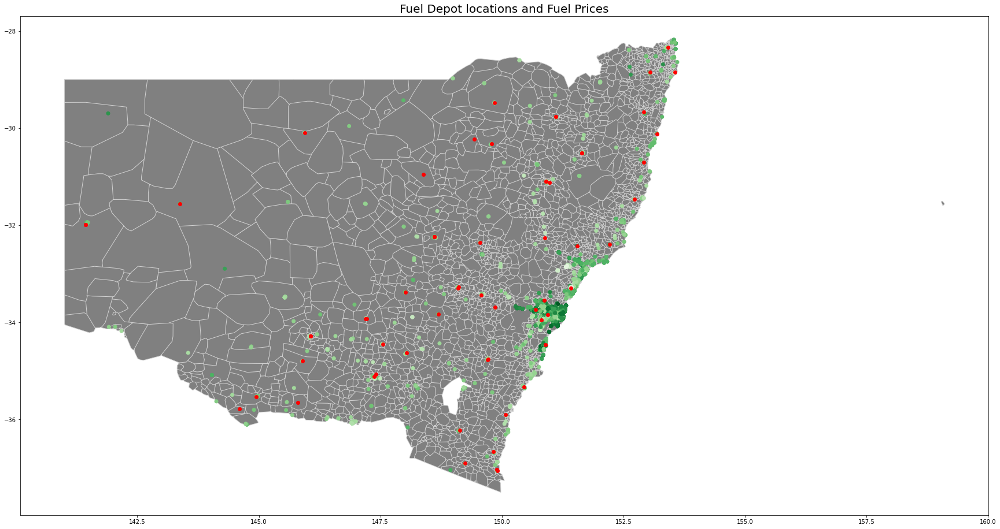

In [197]:
nsw_map = burbs.geometry.convex_hull.plot(facecolor='grey', edgecolor='lightgrey')
plt.scatter(new_fuel_station_coordinates.longitude, new_fuel_station_coordinates.latitude, c=new_fuel_station_coordinates.Price_U91, cmap='Greens')
plt.scatter(fuel_depots.LONGITUDE, fuel_depots.LATITUDE, c = "red")

plt.title("Fuel Depot locations and Fuel Prices", fontsize=20)

Now, lets look at the location for each fuel depots and who owned them. The depots owned by BP are mostly in rural areas whereas Caltax has two of their depots in Sydney. 

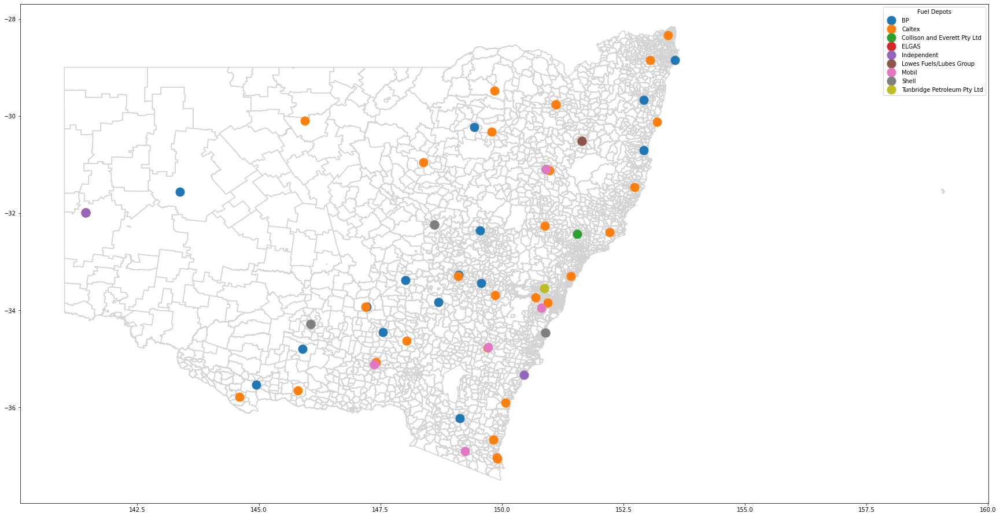

In [196]:
nsw_map = burbs.geometry.boundary.plot(edgecolor='lightgrey')
owners = fuel_depots.groupby("OWNER")
for name, owner in owners:
    plt.plot(owner.LONGITUDE, owner.LATITUDE, marker = 'o', linestyle='', markersize=15, label=name)
plt.legend(title='Fuel Depots')

In [187]:
def new_legend_color(n):
    if n < 119:
        return "Group 0 - 119"
    elif 120 < n < 129:
        return "Group 120-129"
    elif 130 < n < 139:
        return "Group 130-139"
    elif 140 < n <149:
        return "Group 140-149"
    elif 150 < n <159:
        return "Group 150-159"
    elif 160 < n <200:
        return "Group 160-200"
    elif n == str:
        return n

new_fuel_station_coordinates["Price_Group_New"] = new_fuel_station_coordinates.Price_U91.apply(new_legend_color)
new_fuel_station_coordinates.sample(10)

,Unnamed: 0,Address,Brand,Postcode,Price_DL,Price_DL_UpdatedDate,Price_E10,Price_E10_UpdatedDate,Price_E85,Price_E85_UpdatedDate,...,Price_P98_UpdatedDate,Price_PDL,Price_PDL_UpdatedDate,Price_U91,Price_U91_UpdatedDate,ServiceStationName,Suburb,latitude,longitude,Price_Group_New
4311,6089,"280-282 Canley Vale Road, CANLEY HEIGHTS NSW 2166",Caltex,2166.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,134.9,05/10/2021 11:33,NaN,NaN,Caltex Star Mart Canley Heights,CANLEY HEIGHTS,-33.885196,150.935076,None
14728,20307,"118 New England Hwy, Rutherford NSW 2320",Coles Express,2320.0,139.9,05/31/2021 7:30,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Coles Express Rutherford,Rutherford,-32.706944,151.499733,None
13822,19085,"68 Harold St, MACQUARIE FIELDS NSW 2564",Caltex,2564.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,137.9,05/29/2021 6:05,NaN,NaN,Caltex Macquarie Fields,MACQUARIE FIELDS,-33.997596,150.890050,None
14252,19661,"101 Hammond Avenue, Wagga Wagga NSW 2650",Independent,2650.0,128.9,05/30/2021 4:55,128.9,05/30/2021 4:55,NaN,NaN,...,05/30/2021 4:55,NaN,NaN,130.9,05/30/2021 4:55,APCO IGA Wagga,Wagga Wagga,-35.120428,147.379985,Group 130-139
6448,9021,"281 HOMER ST, EARLWOOD NSW 2206",Metro Fuel,2206.0,NaN,NaN,123.9,05/14/2021 6:34,NaN,NaN,...,NaN,125.9,05/14/2021 6:34,NaN,NaN,Metro Petroleum Earlwood,EARLWOOD,-33.923900,151.135810,None
13117,18146,"774 Parramatta Road, Lewisham NSW 2049",Caltex Woolworths,2049.0,NaN,NaN,159.9,05/27/2021 21:21,NaN,NaN,...,05/27/2021 21:21,NaN,NaN,161.9,05/27/2021 21:21,Caltex Woolworths Leichardt,Lewisham,-33.890118,151.147669,Group 160-200
3338,4784,"2893 Nelson Bay Rd, SALT ASH NSW 2318",Caltex,2318.0,NaN,NaN,149.7,05/07/2021 10:05,NaN,NaN,...,05/07/2021 10:05,NaN,NaN,151.7,05/07/2021 10:05,Caltex Salt ash,SALT ASH,-32.792593,151.897630,Group 150-159
5106,7202,"84 Cowabbie St, COOLAMON NSW 2701",Mobil,2701.0,130.9,05/11/2021 13:16,NaN,NaN,NaN,NaN,...,05/11/2021 13:16,NaN,NaN,135.9,05/11/2021 13:16,Mobil Coolamon,COOLAMON,-34.807994,147.197529,Group 130-139
3032,4353,"656 Warringah Road, FORESTVILLE NSW 2087",Metro Fuel,2087.0,NaN,NaN,125.9,05/06/2021 16:54,NaN,NaN,...,NaN,NaN,NaN,127.9,05/06/2021 16:54,Metro Petroleum Forestville,FORESTVILLE,-33.760921,151.216115,Group 120-129
129,190,"95-97 Ramsay St, HABERFIELD NSW 2045",BP,2045.0,NaN,NaN,145.9,05/01/2021 9:23,NaN,NaN,...,05/01/2021 9:23,NaN,NaN,147.9,05/01/2021 9:23,BP Haberfield,HABERFIELD,-33.873291,151.133063,Group 140-149


To follow that up, I have grouped the prices and plot them onto the map. As you can see, Sydney and Wollongong's fuel stations sell the most expensive fuel. It could be the land cost or demand. Followed by New Castle.

Text(0.5, 1.0, 'Price Groups for fuel stations')

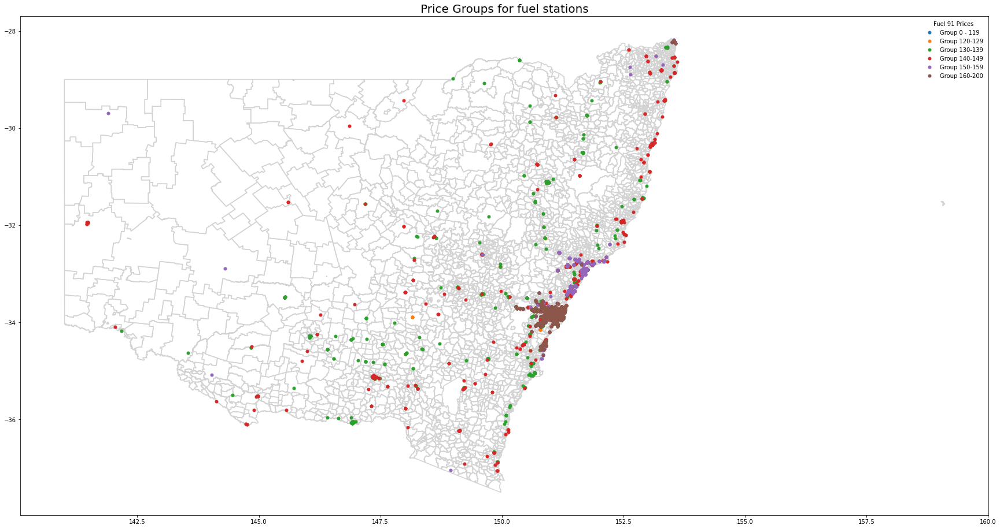

In [195]:
nsw_map = burbs.geometry.boundary.plot(edgecolor='lightgrey')
groups = price_U91.groupby("Price_Group_New")
for name, group in groups:
    plt.plot(group.longitude, group.latitude, marker = "o", linestyle='', markersize = 5, label=name)
plt.legend(scatterpoints=1, frameon=False, title='Fuel 91 Prices')
plt.title('Price Groups for fuel stations', fontsize=20)

Now back to our original question, does fuel stations that are near to a fuel depot sell cheaper fuel prices? The map below indicates that stations near depots do sell their fuel with a cheaper price, however, the stations are also located in the rural areas which have less demand. 

Text(0.5, 1.0, 'Price Groups for fuel stations with fuel depots')

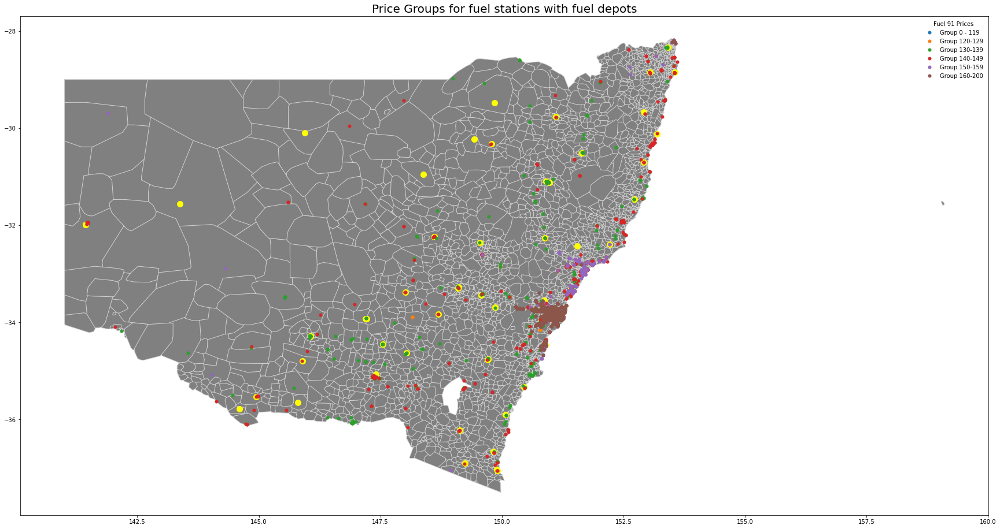

In [199]:
nsw_map = burbs.geometry.convex_hull.plot(facecolor='grey', edgecolor='lightgrey')
groups = price_U91.groupby("Price_Group_New")
for name, group in groups:
    plt.plot(group.longitude, group.latitude, marker = "o", linestyle='', markersize = 5, label=name)
plt.scatter(fuel_depots.LONGITUDE, fuel_depots.LATITUDE, c = "yellow", s=100)
plt.legend(scatterpoints=1, frameon=False, title='Fuel 91 Prices')
plt.title('Price Groups for fuel stations with fuel depots', fontsize=20)

In [190]:
fuel_depots.head()

,OBJECTID,FEATURETYPE,DESCRIPTION,CLASS,FID,NAME,OPERATIONALSTATUS,OPERATOR,OWNER,ADDRESS,SUBURB,STATE,SPATIALCONFIDENCE,REVISED,COMMENT,LATITUDE,LONGITUDE,geometry
0,1,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,52,Eden,Operational,Caltex,Caltex,Lot 23 Ben Boyd Drive,Eden,New South Wales,4,20121004,8 lay Down tanks + 1 lay down tank possibly fo...,-37.038479,149.891540,POINT (149.89154 -37.03848)
1,2,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,53,Temora Fuel Distributors,Operational,Temora Fuel Distributors,BP,9 Ironbark Street,Temora,New South Wales,5,20121004,"3 med + 1 med + 1 separate lay down tank, 2 me...",-34.447685,147.552978,POINT (147.55298 -34.44769)
2,3,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,54,Dubbo,Operational,Inland Petroleum,BP,105 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 1 Terminal sized upright + 10...",-32.244324,148.610268,POINT (148.61027 -32.24432)
3,4,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,55,Dubbo,Operational,Lowes Petroleum Service,Mobil,107 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 5 large + 2 small upright tan...",-32.244473,148.611153,POINT (148.61115 -32.24447)
4,5,Fuel Depot,A facility used for the bulk storage of petrol...,Fuel Depot,56,Dubbo,Operational,Shell,Shell,109-113 Erskine Street,Dubbo,New South Wales,5,20121004,"Station as well, 1 terminal sized + 1 small up...",-32.244732,148.612396,POINT (148.61240 -32.24473)


In [136]:
fuel_station_coordinates.head()

,Number,station,location,latitude,longitude,owner,Price_U91,Price_P98
0,0,"702-704 Warringah Road, Forestville NSW 2087","Warringah Road, Forestville, Sydney, Northern ...",-33.760921,151.216115,Metro Fuel,137.9,155.9
1,2,"125 Brunker Rd, Adamstown NSW 2289","Brunker Road, Adamstown, Newcastle, Newcastle ...",-32.943960,151.722761,Westside,Not Selling U91,158.9
2,3,"323 River Street, BALLINA NSW 2478","323, River Street, Ballina CBD, Ballina, Balli...",-28.866000,153.550280,Metro Fuel,142.9,161.9
3,4,"656 Warringah Road, FORESTVILLE NSW 2087","Warringah Road, Forestville, Sydney, Northern ...",-33.760921,151.216115,Metro Fuel,137.9,Not Selling P98
4,5,"198 Hill End Road, Doonside NSW 2767","Hill End Road, Doonside, Sydney, Blacktown Cit...",-33.761139,150.869841,Metro Fuel,Not Selling U91,Not Selling P98


Lastly, I have a folium map with fuel depots and fuel stations. In the rural areas, there will always be a liberty owned fuel station near the fuel depot. Not sure if thats a coincidence but here you can see, not all the stations near a depot sells cheaper price. It could be the socio economic status of the suburb, or simply just the demand.

In [3]:
map_in_nsw = folium.Map(location=[-33.8688, 151.2093],  zoom_start=10)
for (index, row) in fuel_depots.iterrows():
    folium.Marker(location=[row.loc["LATITUDE"], row.loc["LONGITUDE"]],
                  popup=row.loc["OWNER"], tooltip="Fuel Depots", type_color='green').add_to(map_in_nsw)
    folium.CircleMarker(location=[row.loc["LATITUDE"], row.loc["LONGITUDE"]], radius=100).add_to(map_in_nsw)
for (index, row) in fuel_station_coordinates.iterrows():
    folium.Marker(location=[row.loc["latitude"], row.loc["longitude"]],
                  popup=row.loc["owner"]+" "+"Price U91-"+row.loc["Price_U91"]+" "+"Price P98-"+row.loc["Price_P98"], tooltip="Fuel stations").add_to(map_in_nsw)
map_in_nsw


To conclude, fuel stations near a fuel depot do not actually sell their fuel cheaper. It could be the demand, the rental cost or the socio economy status for the suburb.  However, Sydney definitely has the most expensive fuel prices out of NSW. If you want to look for cheaper fuel prices, download NSW FuelCheck. Thank you for listening. 